<a href="https://colab.research.google.com/github/SharmaAshwini/UNT/blob/main/Methods%20in%20Empirical%20Analysis/Exercise_7_Color_Layout_Descriptor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## ICE-7. MPEG-7 Color Layout Descriptor
Please download the images from the following link:<br>
https://drive.google.com/file/d/1h0JFzpyc7zNZiln5Ls74CfvOfhtl51XK/view?usp=sharing <br><br>
Please refer to the following link for the code of Color Layout Descriptor: <br>
https://github.com/scferrada/imgpedia

## Task 1. Please using the given code to extract the color layout features from the downloaded image 001.jpg, and display it.

In [ ]:
# write you code here


In [ ]:
!gdown --folder 'https://drive.google.com/drive/folders/1dV1XtPmQ8Ke--77Azyvep41CBjdZycnk'

Retrieving folder list
Processing file 14GWK82SZv-5vqSKreqCy0SgJ2YgGgSQt 001.jpg
Processing file 1C6FAGgOhUzLSipx_ztDDi_mZle75R7Kx 002.jpg
Processing file 1PirjwnjZtSrQKUvXlsRHd2kWILR8KJ-y 003.jpg
Processing file 1PYc5i8QPLwNucxDEpLx1IDOO-s-Ju-x7 004.jpg
Processing file 1jEMPfMJluZByy8gS05UrBBpQP4WL7WpP 005.jpg
Processing file 1zPK15i1y6Tlk2kzQrzX8TdXdu7_El_XL 006.jpg
Processing file 1deWjX9qUre_da2lLBYsBuoh6lViiWcdR 007.jpg
Processing file 1pNd1yqobUA4beKaldM2TflQ-8-Wm5HLo 008.jpg
Processing file 1NyT26iZg3iMV3pG8Tk6Z5y5Q2etLFuTw 009.jpg
Processing file 1DxkYT_w5Pug3g1BhAkW5vN3jCn9jD9K5 010.jpg
Processing file 1zskjhF6K1W0-H0RANWBFevA0YjofxrHf 011.jpg
Processing file 1eSvOlEjWx2O4_lQsie2hgYES4SE5ciUo 012.jpg
Processing file 1MnRkPzkQInIuzMITWdnsnSNyMYyoTUux 013.jpg
Processing file 1BrQnecHc6Hcc9h9ywdpOtSz7vMrlrdNq 014.jpg
Processing file 1edcY8L1iiGTjH1Vp2ELb95MBlxUx3Nr7 015.jpg
Processing file 18ONEzTJ2nUdGzWXWrqfsUGLIKX9_cgD8 016.jpg
Processing file 1ov9W-w7Wmcn7QYSrRGRryAXdwawu1gtM

##Color Layout Computer Function

In [ ]:
import cv2, sys, os
import numpy as np
import matplotlib.pyplot as plt


class ColorLayoutComputer():

	def __init__(self):
		self.rows = 8
		self.cols = 8
		self.prefix = "CLD"

	def compute(self, img):
		averages = np.zeros((self.rows,self.cols,3))
		imgH, imgW, _ = img.shape
		for row in range(self.rows):
			for col in range(self.cols):
				slice = img[int(imgH/self.rows * row): int(imgH/self.rows * (row+1)), int(imgW/self.cols*col) : int(imgW/self.cols*(col+1))]
				average_color_per_row = np.mean(slice, axis=0)
				average_color = np.mean(average_color_per_row, axis=0)
				average_color = np.uint8(average_color)
				averages[row][col][0] = average_color[0]
				averages[row][col][1] = average_color[1]
				averages[row][col][2] = average_color[2]
		icon = cv2.cvtColor(np.array(averages, dtype=np.uint8), cv2.COLOR_BGR2YCR_CB)
		y, cr, cb = cv2.split(icon)
		dct_y = cv2.dct(np.float32(y))
		dct_cb = cv2.dct(np.float32(cb))
		dct_cr = cv2.dct(np.float32(cr))
		dct_y_zigzag = []
		dct_cb_zigzag = []
		dct_cr_zigzag = []
		flip = True
		flipped_dct_y = np.fliplr(dct_y)
		flipped_dct_cb = np.fliplr(dct_cb)
		flipped_dct_cr = np.fliplr(dct_cr)
		for i in range(self.rows + self.cols -1):
			k_diag = self.rows - 1 - i
			diag_y = np.diag(flipped_dct_y, k=k_diag)
			diag_cb = np.diag(flipped_dct_cb, k=k_diag)
			diag_cr = np.diag(flipped_dct_cr, k=k_diag)
			if flip:
				diag_y = diag_y[::-1]
				diag_cb = diag_cb[::-1]
				diag_cr = diag_cr[::-1]
			dct_y_zigzag.append(diag_y)
			dct_cb_zigzag.append(diag_cb)
			dct_cr_zigzag.append(diag_cr)
			flip = not flip
		return np.concatenate([np.concatenate(dct_y_zigzag), np.concatenate(dct_cb_zigzag), np.concatenate(dct_cr_zigzag)])

In [ ]:
img = cv2.imread("ICE-7_data/001.jpg")
imgH, imgW, _ = img.shape
rows = 8
cols = 8
print(f"image shape is: {img.shape}")
print(imgH/rows)
print(imgW/cols)

computer = ColorLayoutComputer()
img_1 = cv2.imread("ICE-7_data/001.jpg")
descriptor_img1 = computer.compute(img_1)
print(f"\ndescriptor shape is {descriptor_img1.shape}")

image shape is: (480, 640, 3)
60.0
80.0

descriptor shape is (192,)


In [ ]:
#Color Layout Descriptor for image 1
print(descriptor_img1)

[ 7.54875000e+02 -3.71453323e+01 -2.75390893e-01 -2.05506821e+02
  7.78468102e-02 -2.34176540e+01 -3.93178177e+01  3.43435440e+01
  2.75409832e+01 -5.34272051e+00 -4.38750000e+01  5.65796041e+00
  2.59727240e+00 -2.54444008e+01 -1.43750000e+01 -2.34878922e+01
  2.55022869e+01  2.20043163e+01 -3.80048065e+01 -5.47946072e+00
  6.65629059e-02  5.35990372e+01 -1.31532040e+01  2.22179368e-01
  4.08514328e+01 -2.71923709e+00 -2.33335533e+01 -7.21246767e+00
 -2.86610723e+00  1.22206163e+01  3.80418777e+00 -3.12251759e+01
  3.03049412e+01  1.38942504e+00  7.60543251e+00  1.85286961e+01
  1.82548904e+01 -2.60280678e-03 -1.26275692e+01  2.58750000e+01
  2.63148155e+01 -3.00260210e+00 -2.30272079e+00 -2.49541059e-01
 -1.75480080e+01  2.62883568e+01  8.04879284e+00 -2.93222847e+01
  1.81053467e+01 -1.63744450e+01 -1.93038082e+01  1.69019365e+00
  8.70240688e+00  1.83429193e+00  4.75085020e+00  5.05936050e+00
 -1.27258711e+01 -8.98755074e+00 -8.12548637e+00  6.52728260e-01
  2.36595964e+00 -1.14373

## Task 2. Retrieve the image that is the most similar to image 001.jpg from the downloaded images (not itself).
Please try to use at least three different metrics to measure the distance between color layout descriptors (L1 distance, L2 distance, earth mover's distance, etc)

In [ ]:
# write you code here


In [ ]:
#Calculate descriptors for all 17 images and save in a dictionary

computer = ColorLayoutComputer()
descriptor_dict = {}
files = []

for (dirpath, dirnames, filenames) in os.walk("ICE-7_data"):
				files.extend(filenames)

files.sort()
print(files)

i = 1
for file in files:
  img = cv2.imread(os.path.join("ICE-7_data", file))
  desc = computer.compute(img)
  descriptor_dict['img'+str(i)] = desc
  i = i + 1


print('\n')
print(descriptor_dict)

['001.jpg', '002.jpg', '003.jpg', '004.jpg', '005.jpg', '006.jpg', '007.jpg', '008.jpg', '009.jpg', '010.jpg', '011.jpg', '012.jpg', '013.jpg', '014.jpg', '015.jpg', '016.jpg', '017.jpg']


{'img1': array([ 7.54875000e+02, -3.71453323e+01, -2.75390893e-01, -2.05506821e+02,
        7.78468102e-02, -2.34176540e+01, -3.93178177e+01,  3.43435440e+01,
        2.75409832e+01, -5.34272051e+00, -4.38750000e+01,  5.65796041e+00,
        2.59727240e+00, -2.54444008e+01, -1.43750000e+01, -2.34878922e+01,
        2.55022869e+01,  2.20043163e+01, -3.80048065e+01, -5.47946072e+00,
        6.65629059e-02,  5.35990372e+01, -1.31532040e+01,  2.22179368e-01,
        4.08514328e+01, -2.71923709e+00, -2.33335533e+01, -7.21246767e+00,
       -2.86610723e+00,  1.22206163e+01,  3.80418777e+00, -3.12251759e+01,
        3.03049412e+01,  1.38942504e+00,  7.60543251e+00,  1.85286961e+01,
        1.82548904e+01, -2.60280678e-03, -1.26275692e+01,  2.58750000e+01,
        2.63148155e+01, -3.00260210e+00, -2.3027207


 image 1:


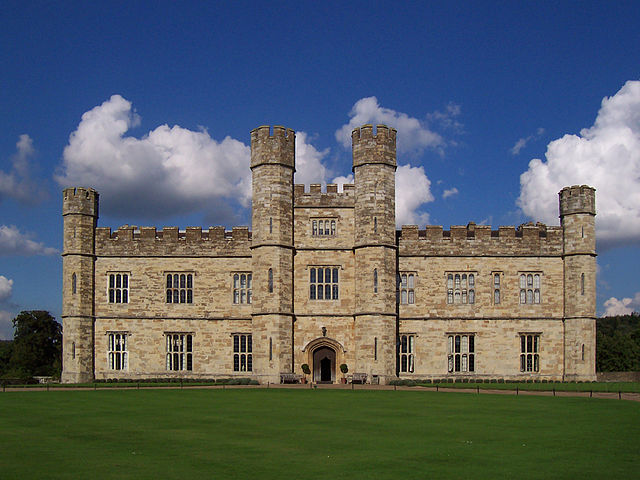


 image 2 to image 7:


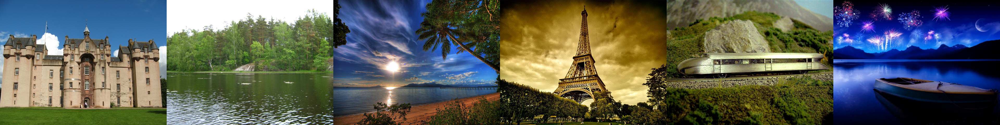


 image 8 to image 10:


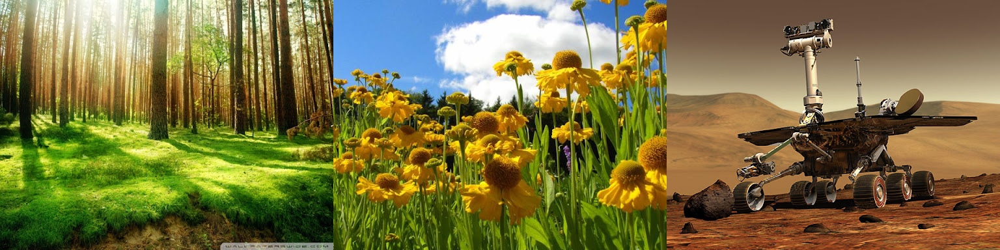


 image 12 to image 17:


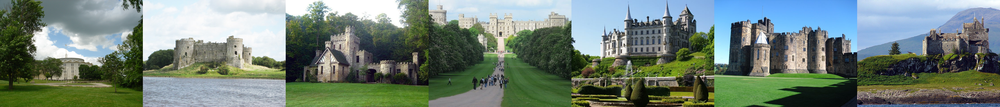

In [ ]:
#Reading and displaying all images (using dictionary) for reference and easy comparison
import matplotlib.pyplot as plt
import pylab
from google.colab.patches import cv2_imshow

image_dict = {}

for cnt in range(1, 18):
  img = cv2.imread(f"ICE-7_data/{cnt:03}.jpg")
  image_dict[str(f"{cnt:03}")+'.jpg'] = img

print('\n image 1:')
cv2_imshow(image_dict['001.jpg'])

print('\n image 2 to image 7:')
merged_images_2_7 = np.hstack((image_dict['002.jpg'], image_dict['003.jpg'], image_dict['004.jpg'], image_dict['005.jpg'], image_dict['006.jpg'], image_dict['007.jpg']))
cv2_imshow(merged_images_2_7)


print('\n image 8 to image 10:')
merged_images_8_10 = np.hstack((image_dict['008.jpg'], image_dict['009.jpg'], image_dict['010.jpg']))
cv2_imshow(merged_images_8_10)

print('\n image 12 to image 17:')
merged_images_11_17 = np.hstack((image_dict['011.jpg'], image_dict['012.jpg'], image_dict['013.jpg'], image_dict['014.jpg'], image_dict['015.jpg'], image_dict['016.jpg'], image_dict['017.jpg']))
cv2_imshow(merged_images_11_17)


##Distance Matrix - 1, Euclidean Distance

In [ ]:
#Euclidean Distance

euclidean_distance_dict = {}

for cnt in range(2, 18):
  point1 = descriptor_dict['img1']
  point2 = descriptor_dict['img'+str(cnt)]

  # finding sum of squares
  sum_sq = np.sum(np.square(point1 - point2))
  euclidean_distance_dict[str(f"{cnt:03}")] = np.sqrt(sum_sq)
  print(f"Euclidean distance for image {cnt} is {np.sqrt(sum_sq)}")


print('\nEuclidean distance dictionary for all images:')
print(euclidean_distance_dict)

print('\nMinimum Euclidean distance for image:')
min(euclidean_distance_dict, key=euclidean_distance_dict.get)

Euclidean distance for image 2 is 337.9216003417969
Euclidean distance for image 3 is 778.3617553710938
Euclidean distance for image 4 is 383.6912841796875
Euclidean distance for image 5 is 541.74072265625
Euclidean distance for image 6 is 448.4283752441406
Euclidean distance for image 7 is 622.9815063476562
Euclidean distance for image 8 is 621.807861328125
Euclidean distance for image 9 is 619.4392700195312
Euclidean distance for image 10 is 447.0771789550781
Euclidean distance for image 11 is 507.5677185058594
Euclidean distance for image 12 is 926.411376953125
Euclidean distance for image 13 is 683.6446533203125
Euclidean distance for image 14 is 702.222900390625
Euclidean distance for image 15 is 556.5231323242188
Euclidean distance for image 16 is 525.6262817382812
Euclidean distance for image 17 is 627.4208984375

Euclidean distance dictionary for all images:
{'002': 337.9216, '003': 778.36176, '004': 383.69128, '005': 541.7407, '006': 448.42838, '007': 622.9815, '008': 621.8078

'002'

Most similar to image 1 using Euclidean distance
002.jpg

joining image 1 to most similar image:


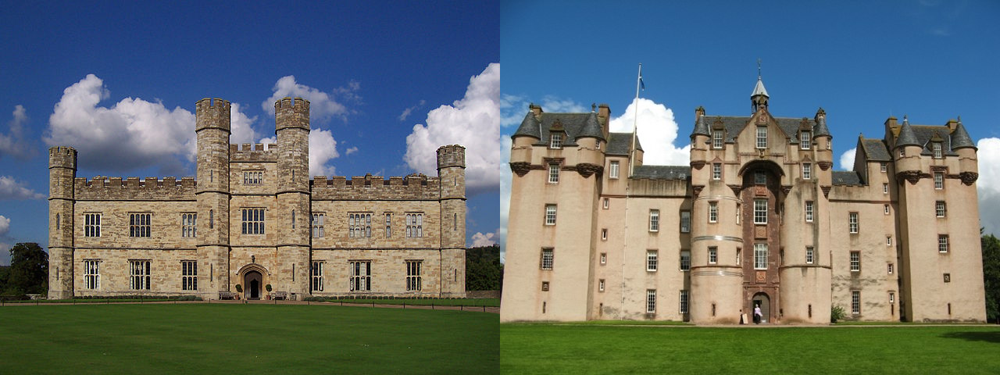

In [ ]:
#Most similar outcome

print("Most similar to image 1 using Euclidean distance")
img_num = min(euclidean_distance_dict, key=euclidean_distance_dict.get)
img_name = img_num + '.jpg'
print(img_name)
print('\njoining image 1 to most similar image:')
merged_images_1_best = np.hstack((image_dict['001.jpg'], image_dict[img_name]))
cv2_imshow(merged_images_1_best)

In [ ]:
#Another method to calculate Euclidean distance using library function
from scipy.spatial import distance


point1 = descriptor_dict['img1']
point2 = descriptor_dict['img2']
distance.euclidean(point1, point2)

337.9216003417969

##Distance Matrix - 2, Cosine Distance

In [ ]:
from scipy.spatial import distance


point1 = descriptor_dict['img1']
point2 = descriptor_dict['img2']

cosine_distance_dict = {}

for cnt in range(2, 18):
  point1 = descriptor_dict['img1']
  point2 = descriptor_dict['img'+str(cnt)]
  cosine_distance_dict[str(f"{cnt:03}")] = distance.cosine(point1, point2)
  print(f"Cosine distance for image {cnt} is {distance.cosine(point1, point2)}")


print('\Cosine distance dictionary for all images:')
print(cosine_distance_dict)

print('\nMinimum Cosine distance for image:')
min(cosine_distance_dict, key=cosine_distance_dict.get)

Cosine distance for image 2 is 0.01851862668991089
Cosine distance for image 3 is 0.10034114122390747
Cosine distance for image 4 is 0.026923656463623047
Cosine distance for image 5 is 0.053234100341796875
Cosine distance for image 6 is 0.03673368692398071
Cosine distance for image 7 is 0.07015222311019897
Cosine distance for image 8 is 0.07132065296173096
Cosine distance for image 9 is 0.06696152687072754
Cosine distance for image 10 is 0.03542524576187134
Cosine distance for image 11 is 0.046707212924957275
Cosine distance for image 12 is 0.09410732984542847
Cosine distance for image 13 is 0.08286374807357788
Cosine distance for image 14 is 0.08566939830780029
Cosine distance for image 15 is 0.05342131853103638
Cosine distance for image 16 is 0.046248793601989746
Cosine distance for image 17 is 0.06468415260314941
\Cosine distance dictionary for all images:
{'002': 0.01851862668991089, '003': 0.10034114122390747, '004': 0.026923656463623047, '005': 0.053234100341796875, '006': 0.0367

'002'

Most similar to image 1 using Cosine distance
002.jpg

joining image 1 to most similar image:


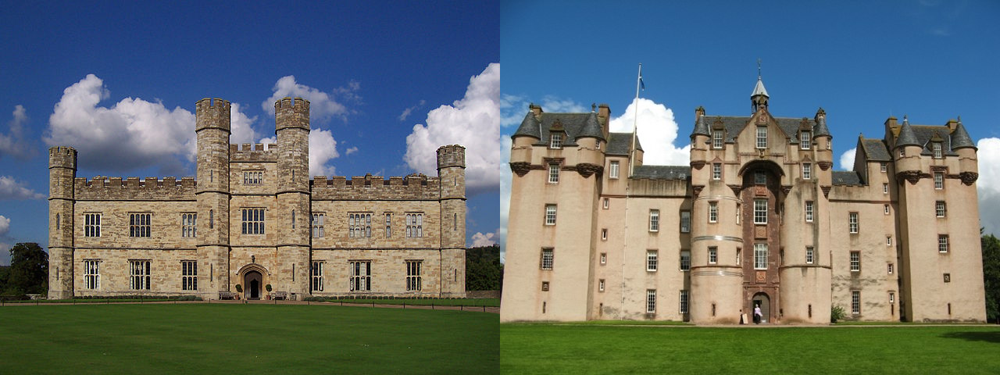

In [ ]:
#Most similar outcome

print("Most similar to image 1 using Cosine distance")
img_num = min(cosine_distance_dict, key=cosine_distance_dict.get)
img_name = img_num + '.jpg'
print(img_name)
print('\njoining image 1 to most similar image:')
merged_images_1_best = np.hstack((image_dict['001.jpg'], image_dict[img_name]))
cv2_imshow(merged_images_1_best)

##Distance Matrix - 3, Manhattan Distance

In [ ]:
from scipy.spatial import distance


point1 = descriptor_dict['img1']
point2 = descriptor_dict['img2']

manhattan_distance_dict = {}

for cnt in range(2, 18):
  point1 = descriptor_dict['img1']
  point2 = descriptor_dict['img'+str(cnt)]
  manhattan_distance_dict[str(f"{cnt:03}")] = distance.cityblock(point1, point2)
  print(f"Manhattan distance for image {cnt} is {distance.cityblock(point1, point2)}")


print('\Manhattan distance dictionary for all images:')
print(manhattan_distance_dict)

print('\nMinimum Manhattan distance for image:')
min(manhattan_distance_dict, key=manhattan_distance_dict.get)

Manhattan distance for image 2 is 2374.996826171875
Manhattan distance for image 3 is 3898.565673828125
Manhattan distance for image 4 is 3270.576416015625
Manhattan distance for image 5 is 3543.37353515625
Manhattan distance for image 6 is 3105.93505859375
Manhattan distance for image 7 is 3915.11083984375
Manhattan distance for image 8 is 3565.516845703125
Manhattan distance for image 9 is 4331.29052734375
Manhattan distance for image 10 is 3119.416259765625
Manhattan distance for image 11 is 3608.269775390625
Manhattan distance for image 12 is 3830.965087890625
Manhattan distance for image 13 is 3671.623046875
Manhattan distance for image 14 is 3659.251953125
Manhattan distance for image 15 is 3315.221435546875
Manhattan distance for image 16 is 3527.913818359375
Manhattan distance for image 17 is 3410.265380859375
\Manhattan distance dictionary for all images:
{'002': 2374.9968, '003': 3898.5657, '004': 3270.5764, '005': 3543.3735, '006': 3105.935, '007': 3915.1108, '008': 3565.516

'002'

Most similar to image 1 using Manhattan distance
002.jpg

joining image 1 to most similar image:


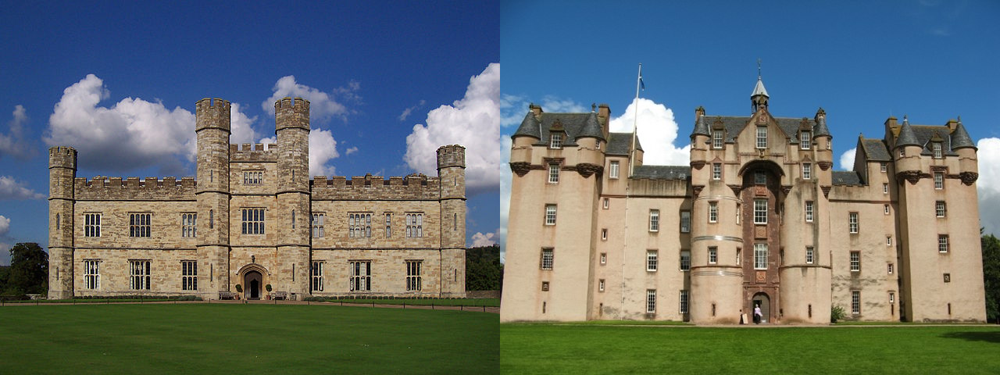

In [ ]:
#Most similar outcome

print("Most similar to image 1 using Manhattan distance")
img_num = min(manhattan_distance_dict, key=manhattan_distance_dict.get)
img_name = img_num + '.jpg'
print(img_name)
print('\njoining image 1 to most similar image:')
merged_images_1_best = np.hstack((image_dict['001.jpg'], image_dict[img_name]))
cv2_imshow(merged_images_1_best)

## Question 1. Please answer if the outputs of Task 2 are the same. If the outputs are different, based on your perspective, which metrics gives the most similar retrieval? If the outputs are the same, do you think we can use any metrics to compare the color layout features in any cases? Give an explanation to your answer.

**Answer to Q1**: type your answer here


All methods are producing image 2 as most similar image to image 1

---

## Image Filtering



## (Tutorial) Convolutional filter
Please review the following article for further understanding of Convolutional layer in Convolutional Neural Network
https://machinelearningmastery.com/convolutional-layers-for-deep-learning-neural-networks/ <br>
Please download the image from the following link for the your program <br>
https://drive.google.com/file/d/1MSQ8e0nxoBIkcp5sdo8Vd-65b9okx6hX/view?usp=sharing

* use pip install opencv-python to install cv2

## Example. Convolutional filter

In [ ]:
!gdown '1dVIsHNlQwz7I8BzBWsFcpFimFffiVSQr'

Access denied with the following error:

 	Cannot retrieve the public link of the file. You may need to change
	the permission to 'Anyone with the link', or have had many accesses. 

You may still be able to access the file from the browser:

	 https://drive.google.com/uc?id=1dVIsHNlQwz7I8BzBWsFcpFimFffiVSQr 



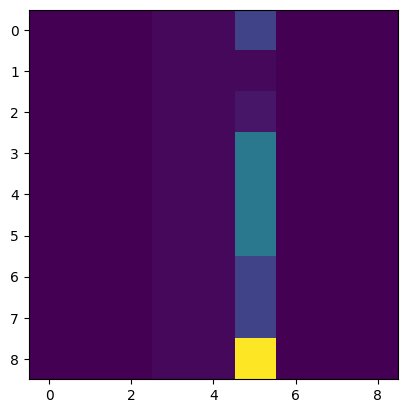

[[  0   0   0   5   0  77   0   0   0]
 [  0   0   0   3   0   0   0   0   0]
 [  0   0   0   3   0   0   0   0   0]
 [  0   0   0   3   0 134   0   0   0]
 [  0   0   0   3   0 117   0   0   0]
 [  0   0   0   3   0 127   0   0   0]
 [  0   0   0   3   0  47   0   0   0]
 [  0   0   0   3   0  17   0   0   0]
 [  0   0   0   5   0 255   0   0   0]]


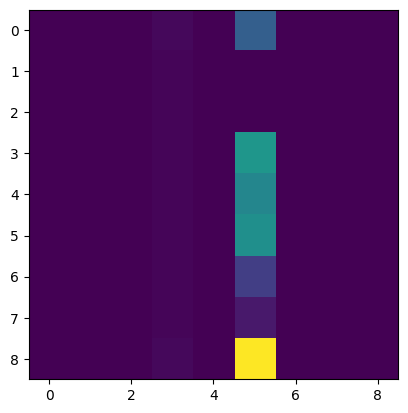

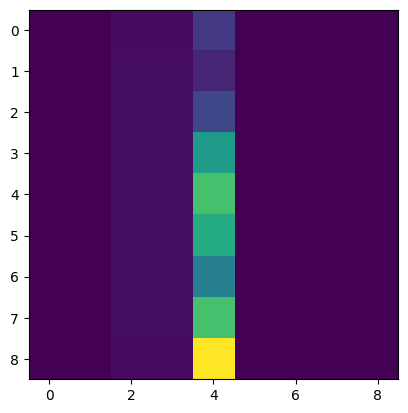

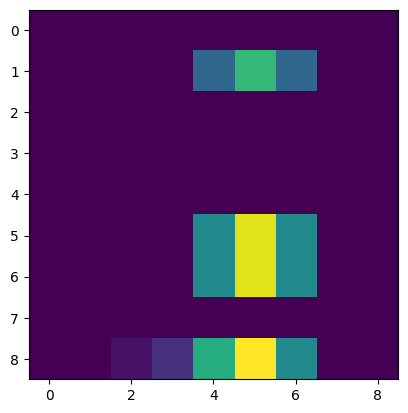

In [ ]:
import matplotlib.pyplot as plt
import pylab
import cv2
import numpy as np

# build the test data
data = np.array([[0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0],
       [0, 0, 0, 1, 1, 3, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 50, 0, 0, 0]], dtype='uint8')
plt.imshow(data)
pylab.show()

#build the convolutional kernel
fil = np.array([[ -1, -1, -1],
                [ -1, 8, -1],
                [ -1, -1, -1]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil, borderType=cv2.BORDER_CONSTANT)
print(res)

plt.imshow(res)
pylab.show()




#Sobel sx
fil = np.array([[ -1, 0, 1],
                [ -2, 0, 2],
                [ -1, 0, 1]])
res = cv2.filter2D(data,-1,fil, borderType=cv2.BORDER_CONSTANT)
plt.imshow(res)
pylab.show()


#Sobel sy
fil = np.array([[ 1, 2, 1],
                [ 0, 0, 0],
                [ -1, -2, -1]])
res = cv2.filter2D(data,-1,fil, borderType=cv2.BORDER_CONSTANT)
plt.imshow(res)
pylab.show()

## Task 3. Building three different kernels for different purposes, and commenting the purpose of each kernel
For instance, the kernel in the example is using for edge extraction

In [ ]:
# write your code here

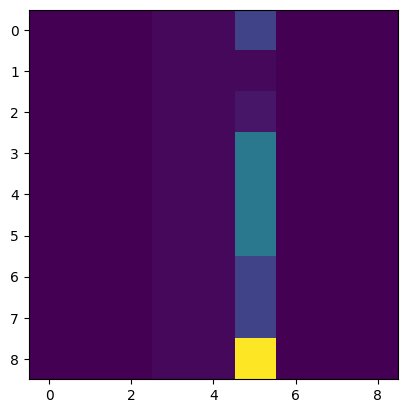

In [ ]:
# build the test data
data = np.array([[0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0],
       [0, 0, 0, 1, 1, 3, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 50, 0, 0, 0]], dtype='uint8')
plt.imshow(data)
pylab.show()

##Trying different Kernels

vertical-1:


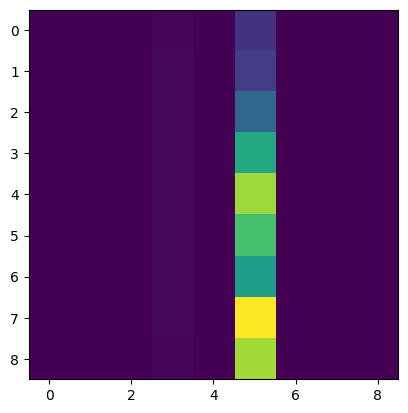

horizontal-1:
[[ 0  0  1  2 21 20 19  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 17 17 17  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 10 10 10  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  1  2 92 91 90  0  0]]


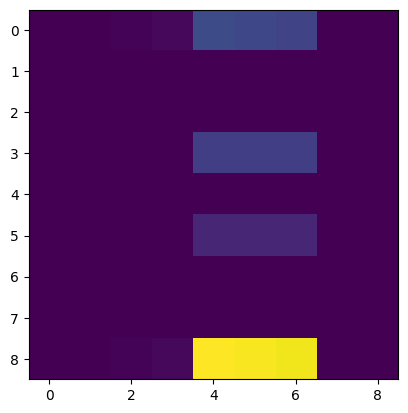

45 degree
[[ 0  0  0  0  0 20  0  0  0]
 [ 0  0  0  0 16  0  0  0  0]
 [ 0  0  0  0  0  0 36  0  0]
 [ 0  0  0  0  0 17 17  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 10 10  0  0  0]
 [ 0  0  0  0 20  0  0  0  0]
 [ 0  0  0  0  0  0 80  0  0]
 [ 0  0  1  2  0 88  0  0  0]]


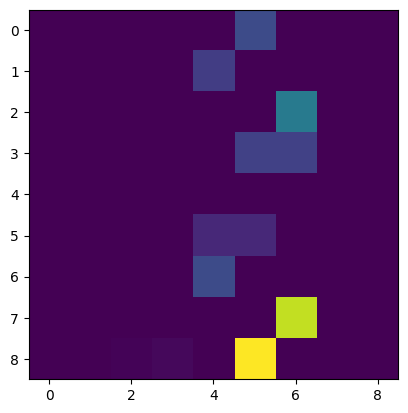

135 degree
[[ 0  0  1  2  0 17  0  0  0]
 [ 0  0  0  0  0  0 16  0  0]
 [ 0  0  0  0 36  0  0  0  0]
 [ 0  0  0  0 17 17  0  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 10 10  0  0]
 [ 0  0  0  0  0  0 20  0  0]
 [ 0  0  0  0 80  0  0  0  0]
 [ 0  0  0  0  0 91  0  0  0]]


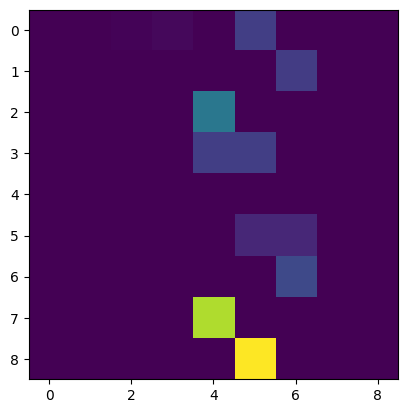

hz + vt: 
[[ 0  0  1  3 13 12 10  0  0]
 [ 0  0  1  4  5 15  1  0  0]
 [ 0  0  1  4  7 25  3  0  0]
 [ 0  0  1  4 24 44 20  0  0]
 [ 0  0  1  4 24 61 20  0  0]
 [ 0  0  1  4 24 51 20  0  0]
 [ 0  0  1  4 14 41 10  0  0]
 [ 0  0  1  4 14 71 10  0  0]
 [ 0  0  1  3 53 61 50  0  0]]


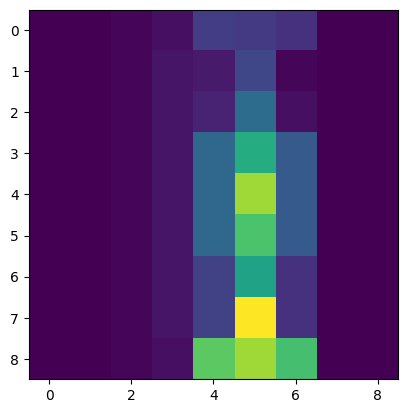

all 1s:
[[ 0  0  2  4 15 13 11  0  0]
 [ 0  0  3  6 20 17 14  0  0]
 [ 0  0  3  6 30 27 24  0  0]
 [ 0  0  3  6 49 46 43  0  0]
 [ 0  0  3  6 66 63 60  0  0]
 [ 0  0  3  6 56 53 50  0  0]
 [ 0  0  3  6 46 43 40  0  0]
 [ 0  0  3  6 76 73 70  0  0]
 [ 0  0  2  4 64 62 60  0  0]]


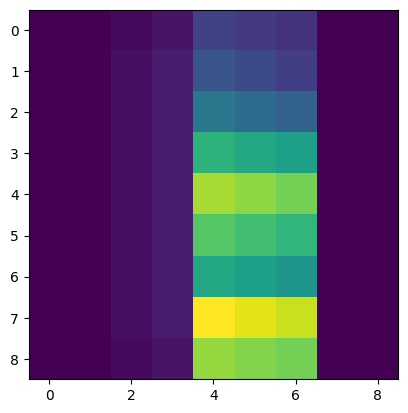

mean:
[[  0   0   3   9  30  45  21   0   0]
 [  0   0   4  12  27  34  15   0   0]
 [  0   0   4  12  39  58  27   0   0]
 [  0   0   4  12  75 130  63   0   0]
 [  0   0   4  12  92 164  80   0   0]
 [  0   0   4  12  82 144  70   0   0]
 [  0   0   4  12  62 104  50   0   0]
 [  0   0   4  12  92 164  80   0   0]
 [  0   0   3   9 119 223 110   0   0]]


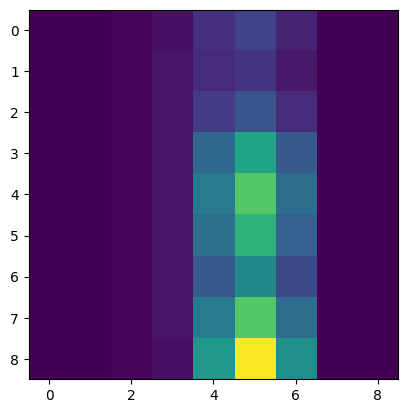

In [ ]:
#Kernel 1, Vertical line detector
fil_vt = np.array([[ -1, 2, -1],
                [ -1, 2, -1],
                [ -1, 2, -1]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical-1:')
#print(res)
plt.imshow(res)
pylab.show()


#Kernel 2, horizontal line detector
fil_hz = np.array([[ -1, -1, -1],
                [ 2, 2, 2],
                [ -1, -1, -1]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal-1:')
print(res)
plt.imshow(res)
pylab.show()


#Kernel 3, detecting 45 degree lines
fil_45 = np.array([[ -1, -1, 2],
                [ -1, 2, -1],
                [ 2, -1, -1]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_45, borderType=cv2.BORDER_CONSTANT)
print('45 degree')
print(res)
plt.imshow(res)
pylab.show()


#Kernel 4, detecting 135 degree lines
fil_135 = np.array([[ 2, -1, -1],
                    [ -1, 2, -1],
                    [ -1, -1, 2]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_135, borderType=cv2.BORDER_CONSTANT)
print('135 degree')
print(res)
plt.imshow(res)
pylab.show()


#Kernel 5, hz + vt
fil_all = np.array([[ 0, 1, 0],
                [ 1, 1, 1],
                [ 0, 1, 0]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_all, borderType=cv2.BORDER_CONSTANT)
print('hz + vt: ')
print(res)
plt.imshow(res)
pylab.show()


#Kernel 6, all 1's
fil_all_1 = np.array([[ 1, 1, 1],
                [ 1, 1, 1],
                [ 1, 1, 1]])

#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_all_1, borderType=cv2.BORDER_CONSTANT)
print('all 1s:')
print(res)
plt.imshow(res)
pylab.show()


#Kernel 7, mean
fil_all_2 = np.array([[ 1, 2, 1],
                [ 2, 4, 2],
                [ 1, 2, 1]])
#use filter2D to apply convolution
res = cv2.filter2D(data,-1,fil_all_2, borderType=cv2.BORDER_CONSTANT)
print('mean:')
print(res)
plt.imshow(res)
pylab.show()

##Kernels which we are going to use in next tasks

vertical lines:


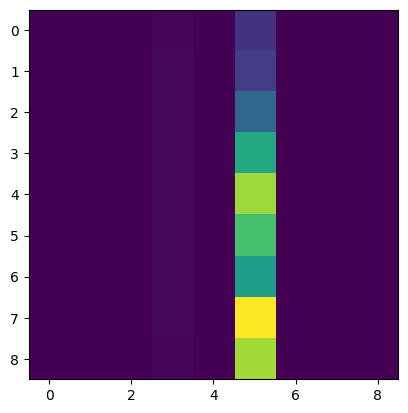

horizontal lines:


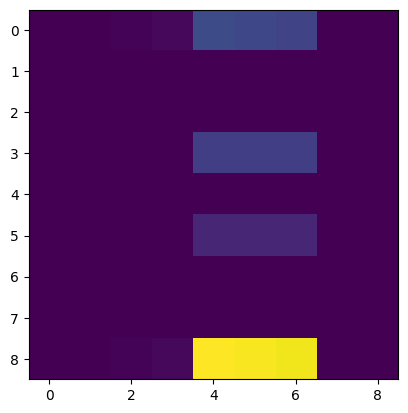

45 degree lines:


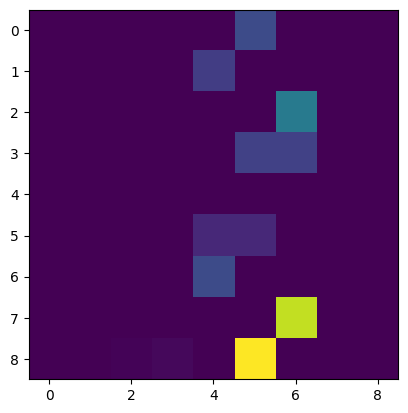

135 degree lines:


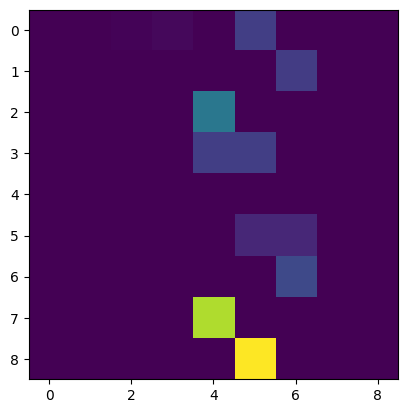

edge detection:


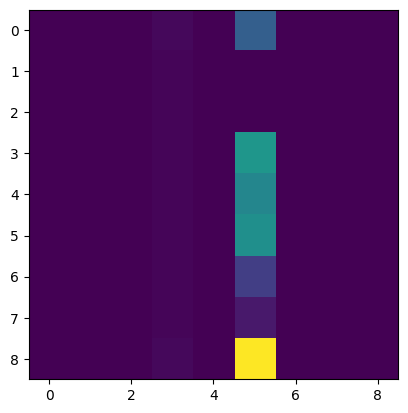

In [ ]:
img = np.array([[0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0],
       [0, 0, 0, 1, 1, 3, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 20, 0, 0, 0],
       [0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 10, 0, 0, 0],
       [0, 0, 0, 1, 1, 50, 0, 0, 0]], dtype='uint8')


#detecting vertical lines
fil_vt = np.array([[ -1, 2, -1],
                   [ -1, 2, -1],
                   [ -1, 2, -1]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical lines:')
plt.imshow(res)
pylab.show()


#horizontal line detector
fil_hz = np.array([[ -1, -1, -1],
                   [  2,  2,  2],
                   [ -1, -1, -1]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal lines:')
plt.imshow(res)
pylab.show()


#detecting 45 degree lines
fil_45 = np.array([[ -1, -1,  2],
                   [ -1,  2, -1],
                   [  2, -1, -1]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_45, borderType=cv2.BORDER_CONSTANT)
print('45 degree lines:')
plt.imshow(res)
pylab.show()


#detecting 135 degree lines
fil_135 = np.array([[ 2,  -1, -1],
                    [ -1, 2,  -1],
                    [ -1, -1, 2]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_135, borderType=cv2.BORDER_CONSTANT)
print('135 degree lines:')
plt.imshow(res)
pylab.show()


#detecting edge
fil_edge = np.array([[ -1,  -1, -1],
                     [ -1,  8,  -1],
                     [ -1,  -1, -1]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_edge, borderType=cv2.BORDER_CONSTANT)
print('edge detection:')
plt.imshow(res)
pylab.show()



## Task 4. Refer to the multiple channels section in the tutorial material, apply the three kernels you built in task 1 to the downloaded image. Visualize the feature maps produced by the three kernels. Combine the three feature maps to a 3-channels feature map and visualize it.

In [ ]:
# write your code here

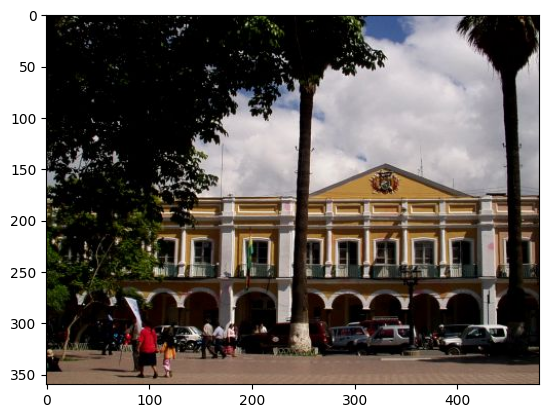

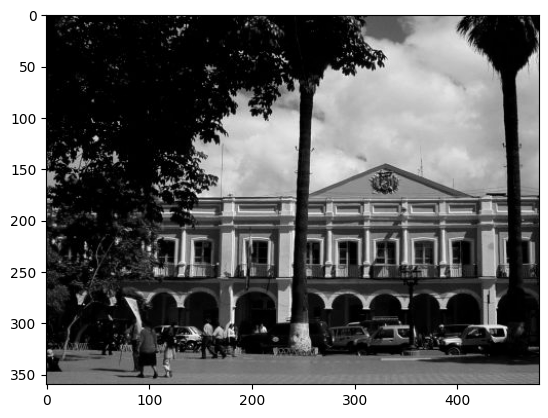

In [ ]:
img_in = cv2.imread("1.jpg")
#img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_orig = cv2.cvtColor(img_in, cv2.COLOR_BGR2RGB)

#Converting to single channel
img = cv2.cvtColor(img_in, cv2.COLOR_BGR2GRAY)
plt.imshow(img_orig)
pylab.show()
plt.imshow(img, cmap="gray")

vertical lines:


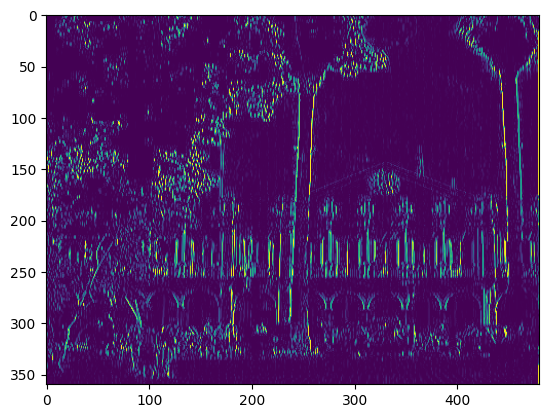

horizontal lines:


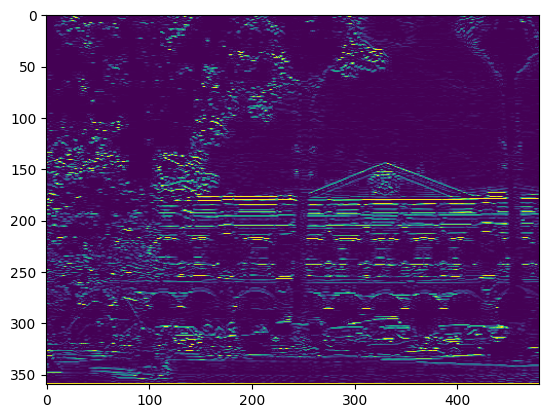

45 degree lines:


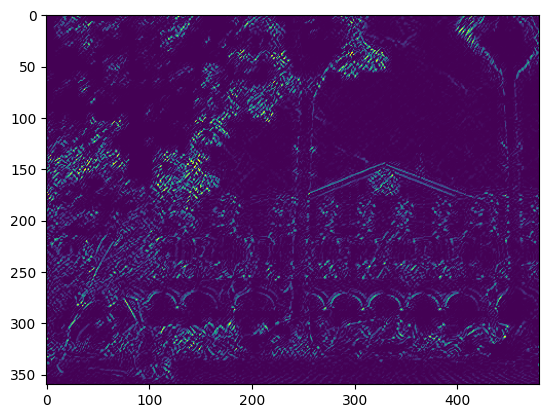

135 degree lines:


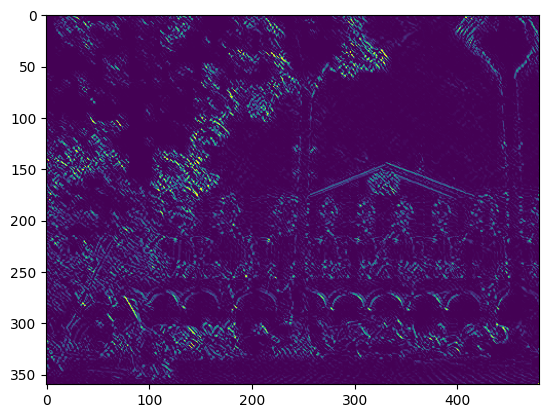

edge detection:


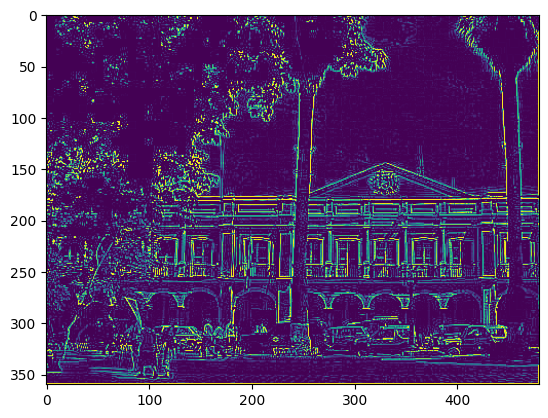

In [ ]:

#detecting vertical lines
fil_vt = np.array([[ -1, 2, -1],
                   [ -1, 2, -1],
                   [ -1, 2, -1]])

#use filter2D to apply convolution
res_vt = cv2.filter2D(img,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical lines:')
plt.imshow(res_vt)
pylab.show()


#horizontal line detector
fil_hz = np.array([[ -1, -1, -1],
                   [  2,  2,  2],
                   [ -1, -1, -1]])

#use filter2D to apply convolution
res_hz = cv2.filter2D(img,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal lines:')
plt.imshow(res_hz)
pylab.show()


#detecting 45 degree lines
fil_45 = np.array([[ -1, -1,  2],
                   [ -1,  2, -1],
                   [  2, -1, -1]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_45, borderType=cv2.BORDER_CONSTANT)
print('45 degree lines:')
plt.imshow(res)
pylab.show()


#detecting 135 degree lines
fil_135 = np.array([[ 2,  -1, -1],
                    [ -1, 2,  -1],
                    [ -1, -1, 2]])

#use filter2D to apply convolution
res = cv2.filter2D(img,-1,fil_135, borderType=cv2.BORDER_CONSTANT)
print('135 degree lines:')
plt.imshow(res)
pylab.show()


#detecting edge
fil_edge = np.array([[ -1,  -1, -1],
                     [ -1,  8,  -1],
                     [ -1,  -1, -1]])

#use filter2D to apply convolution
res_edge = cv2.filter2D(img,-1,fil_edge, borderType=cv2.BORDER_CONSTANT)
print('edge detection:')
plt.imshow(res_edge)
pylab.show()



combined detection:


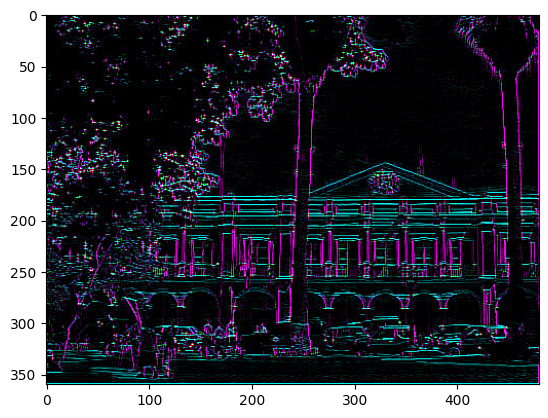

In [ ]:
#Merging feature maps: vertical, horizontal & edge detected
img_out = cv2.merge((res_vt, res_hz, res_edge))
print('combined detection:')
plt.imshow(img_out)

## Task 5. Refer to the multiple layers section in the tutorial material, repeatly apply the three kernels to the combined feature map that created by the previous round two times. Visualize the feature maps produced in the process

In [ ]:
# write your code here

In [ ]:
img_out.shape

(360, 480, 3)

In [ ]:
img_orig.shape

(360, 480, 3)

(360, 480)

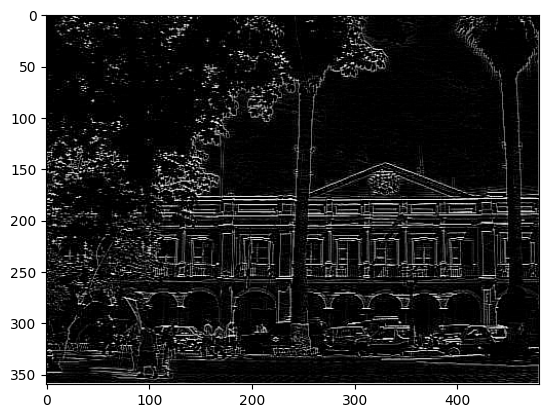

In [ ]:
img_1 = cv2.cvtColor(img_out, cv2.COLOR_BGR2GRAY)
plt.imshow(img_1, cmap="gray")
img_1.shape

vertical lines 1:


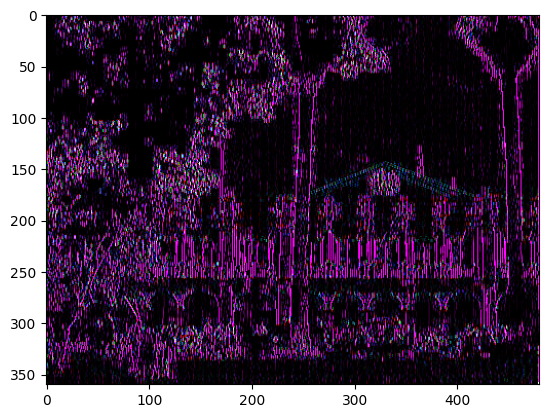

vertical lines 2:


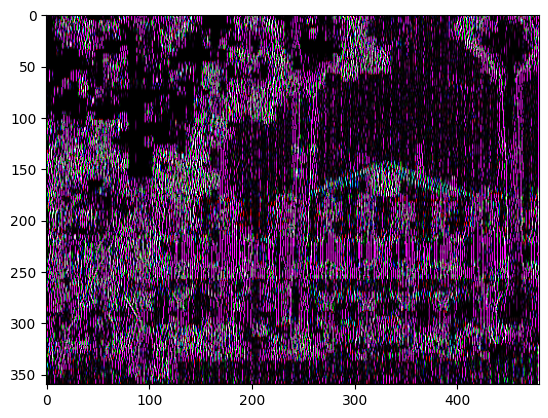

horizontal lines 1:


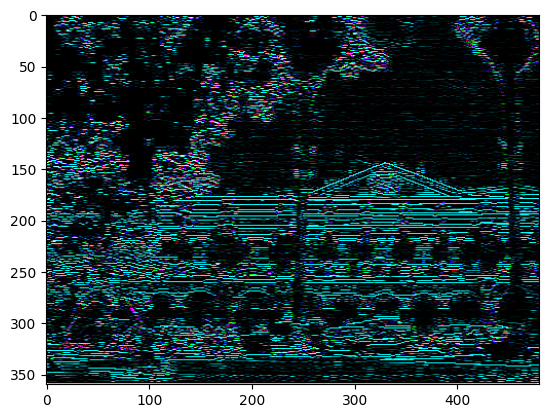

horizontal lines 2:


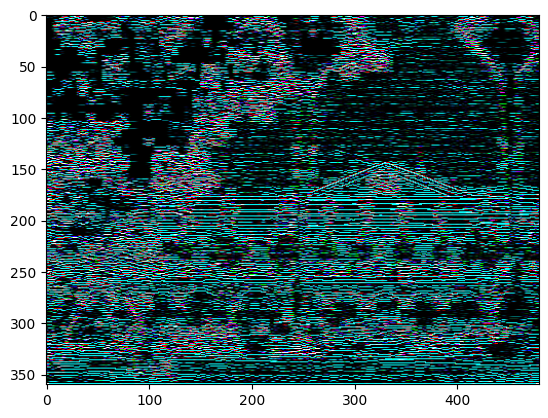

edge detection 1:


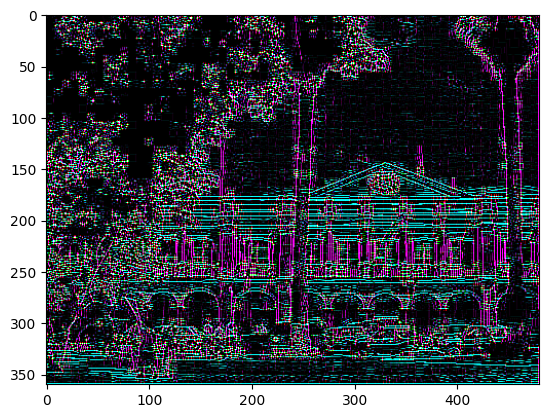

edge detection 2:


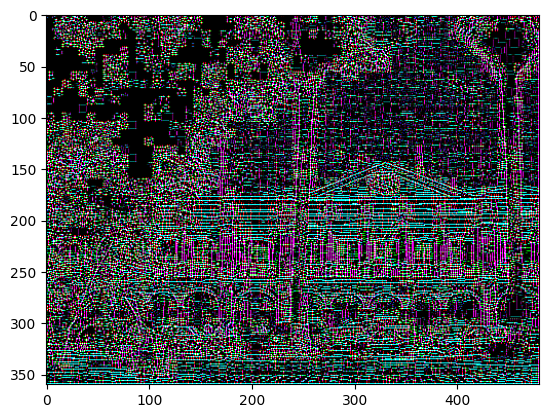


From Task 4: gray image, vertical lines, horizontal lines, edges


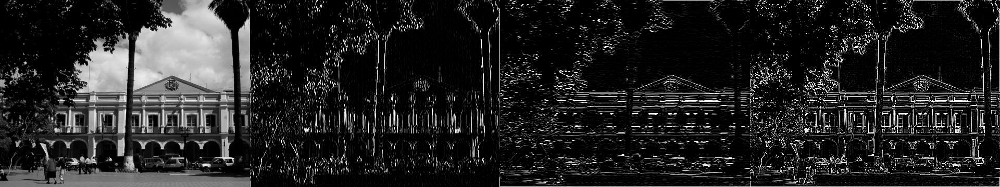


original image


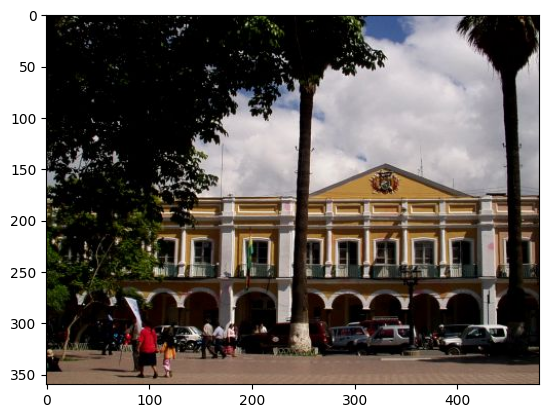


task 4 merged output, 1st vertical iter, 2nd vertical iter


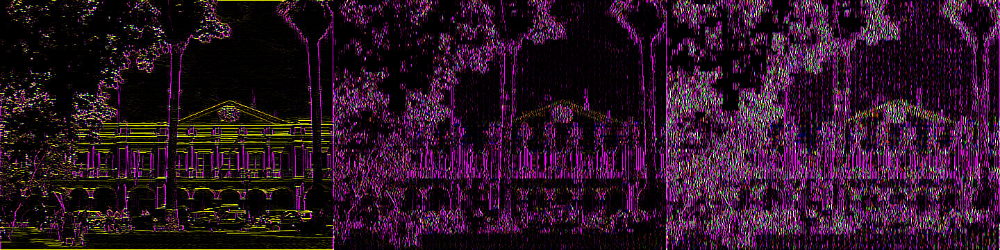


task 4 merged output, 1st horizontal iter, 2nd horizontal iter


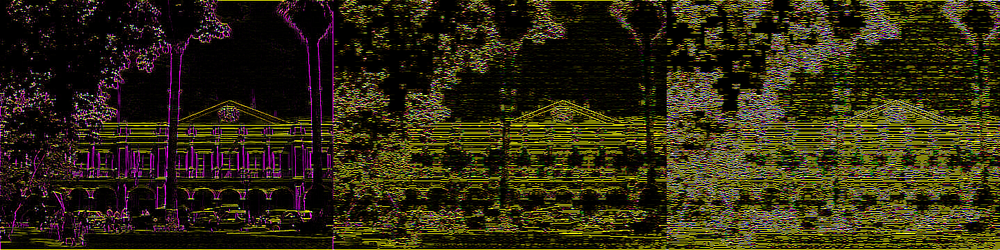


task 4 merged output, 1st edged iter, 2nd edged iter


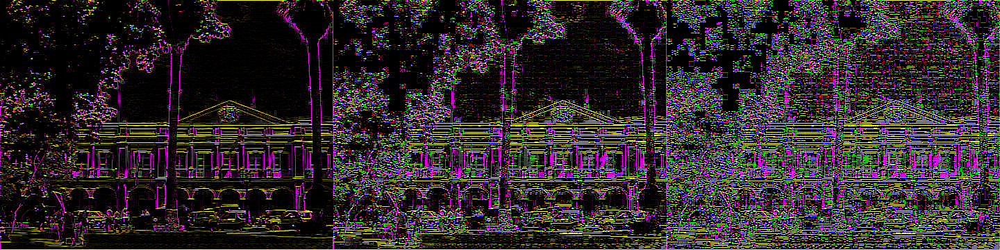

In [ ]:
from google.colab.patches import cv2_imshow

#detecting vertical lines
res_vt1 = cv2.filter2D(img_out,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical lines 1:')
plt.imshow(res_vt1)
pylab.show()

#Iter-2
res_vt2 = cv2.filter2D(res_vt1,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical lines 2:')
plt.imshow(res_vt2)
pylab.show()



#horizontal line detector
#use filter2D to apply convolution
res_hz1 = cv2.filter2D(img_out,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal lines 1:')
plt.imshow(res_hz1)
pylab.show()

#Iter-2
res_hz2 = cv2.filter2D(res_hz1,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal lines 2:')
plt.imshow(res_hz2)
pylab.show()



#detecting edge
#use filter2D to apply convolution
res_edge1 = cv2.filter2D(img_out,-1,fil_edge, borderType=cv2.BORDER_CONSTANT)
print('edge detection 1:')
plt.imshow(res_edge1)
pylab.show()

#Iter-2
res_edge2 = cv2.filter2D(res_edge1,-1,fil_edge, borderType=cv2.BORDER_CONSTANT)
print('edge detection 2:')
plt.imshow(res_edge2)
pylab.show()



#side by side comparison
print('\nFrom Task 4: gray image, vertical lines, horizontal lines, edges')
merge_orig = np.hstack((img, res_vt, res_hz, res_edge))
cv2_imshow(merge_orig)

print('\noriginal image')
plt.imshow(img_orig)
pylab.show()

print('\ntask 4 merged output, 1st vertical iter, 2nd vertical iter')
merge_vt = np.hstack((img_out, res_vt1, res_vt2))
cv2_imshow(merge_vt)

print('\ntask 4 merged output, 1st horizontal iter, 2nd horizontal iter')
merge_hz = np.hstack((img_out, res_hz1, res_hz2))
cv2_imshow(merge_hz)

print('\ntask 4 merged output, 1st edged iter, 2nd edged iter')
merge_edge = np.hstack((img_out, res_edge1, res_edge2))
cv2_imshow(merge_edge)

###Same comparison as last cell, only difference is single channel (gray image)

vertical lines 1:


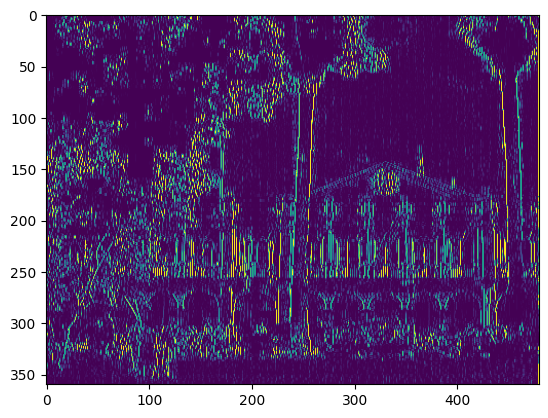

vertical lines 2:


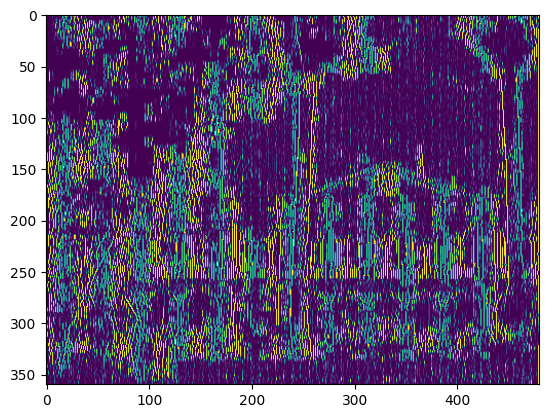

horizontal lines 1:


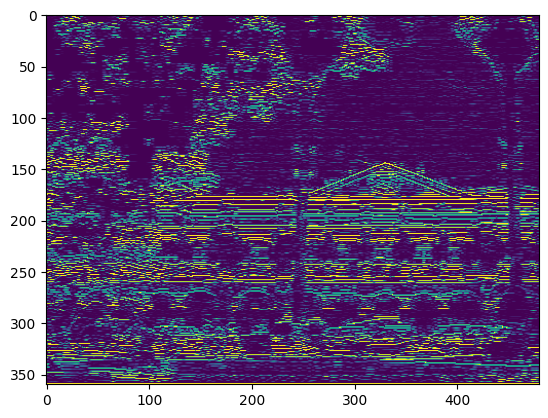

horizontal lines 2:


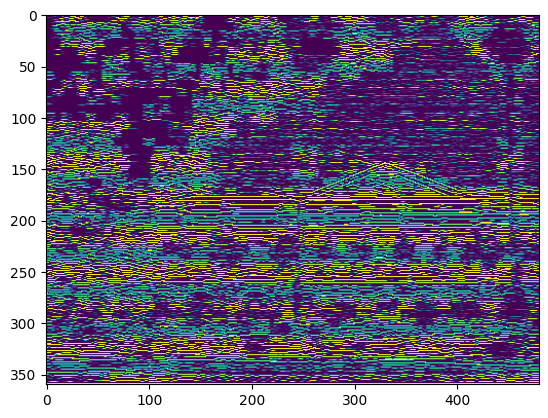

edge detection 1:


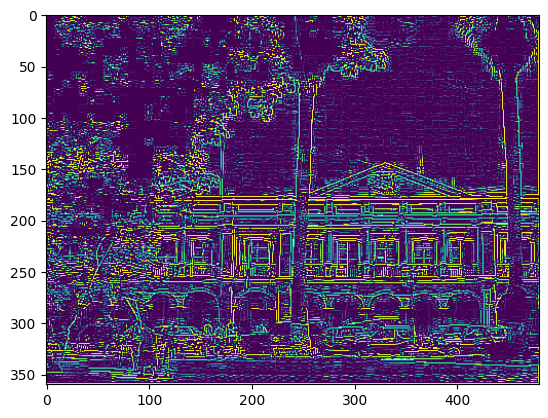

edge detection 2:


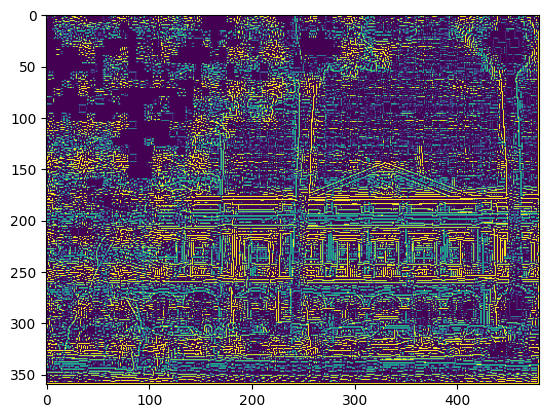


From Task 4: gray image, vertical lines, horizontal lines, edges


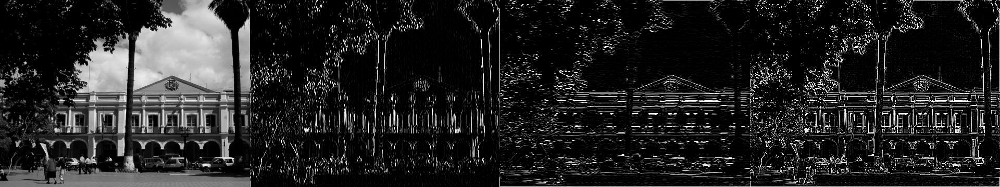


original image


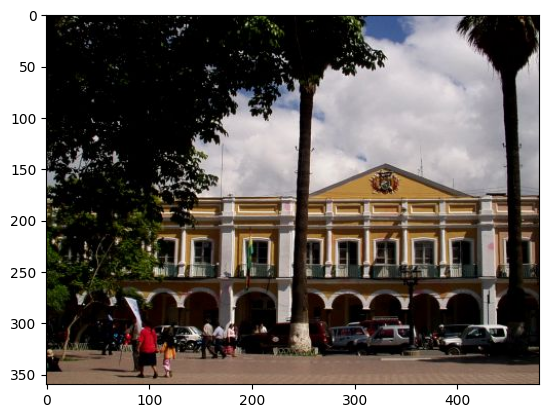


task 4 merged output, 1st vertical iter, 2nd vertical iter


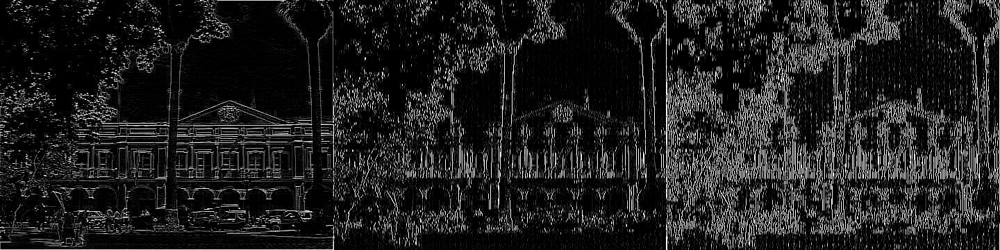


task 4 merged output, 1st horizontal iter, 2nd horizontal iter


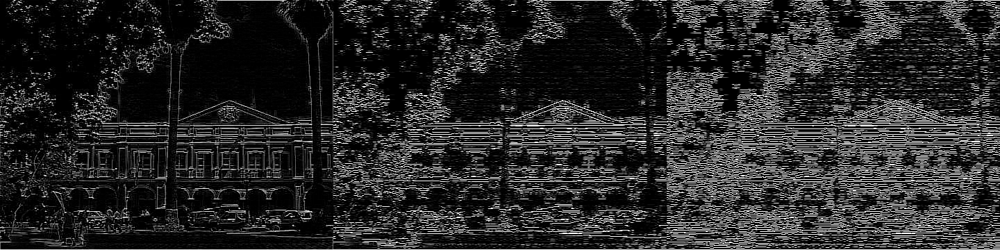


task 4 merged output, 1st edged iter, 2nd edged iter


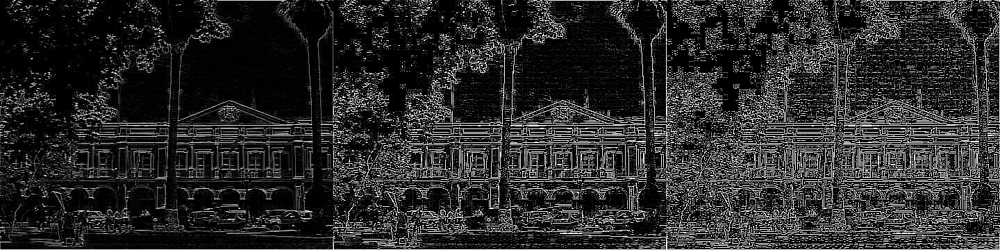

In [ ]:
from google.colab.patches import cv2_imshow

#detecting vertical lines
res_vt1 = cv2.filter2D(img_1,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical lines 1:')
plt.imshow(res_vt1)
pylab.show()

#Iter-2
res_vt2 = cv2.filter2D(res_vt1,-1,fil_vt, borderType=cv2.BORDER_CONSTANT)
print('vertical lines 2:')
plt.imshow(res_vt2)
pylab.show()



#horizontal line detector
#use filter2D to apply convolution
res_hz1 = cv2.filter2D(img_1,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal lines 1:')
plt.imshow(res_hz1)
pylab.show()

#Iter-2
res_hz2 = cv2.filter2D(res_hz1,-1,fil_hz, borderType=cv2.BORDER_CONSTANT)
print('horizontal lines 2:')
plt.imshow(res_hz2)
pylab.show()



#detecting edge
#use filter2D to apply convolution
res_edge1 = cv2.filter2D(img_1,-1,fil_edge, borderType=cv2.BORDER_CONSTANT)
print('edge detection 1:')
plt.imshow(res_edge1)
pylab.show()

#Iter-2
res_edge2 = cv2.filter2D(res_edge1,-1,fil_edge, borderType=cv2.BORDER_CONSTANT)
print('edge detection 2:')
plt.imshow(res_edge2)
pylab.show()



#side by side comparison
print('\nFrom Task 4: gray image, vertical lines, horizontal lines, edges')
merge_orig = np.hstack((img, res_vt, res_hz, res_edge))
cv2_imshow(merge_orig)

print('\noriginal image')
plt.imshow(img_orig)
pylab.show()

print('\ntask 4 merged output, 1st vertical iter, 2nd vertical iter')
merge_vt = np.hstack((img_1, res_vt1, res_vt2))
cv2_imshow(merge_vt)

print('\ntask 4 merged output, 1st horizontal iter, 2nd horizontal iter')
merge_hz = np.hstack((img_1, res_hz1, res_hz2))
cv2_imshow(merge_hz)

print('\ntask 4 merged output, 1st edged iter, 2nd edged iter')
merge_edge = np.hstack((img_1, res_edge1, res_edge2))
cv2_imshow(merge_edge)